In [1]:
import librosa
import librosa.display
import matplotlib.pyplot as plt
import numpy as np
import IPython.display as ipd

In [29]:
# Load the audio file
audio_file = r"..\data\audio_files\processed_download\CloZee - Microworlds.mp3"
y, sr = librosa.load(audio_file, sr=None)
y_harm, y_perc = librosa.effects.hpss(y)

In [57]:
# Track the beats
hop_length = 512  # Example value, define as per your analysis needs
tempo, beats = librosa.beat.beat_track(y=y, sr=sr, hop_length=hop_length)

# Compute beats per measure
beats_per_measure = compute_beats_per_measure(beats)

In [79]:
# Assuming a hop_length, define or calculate it accordingly
hop_length = 512  # Example value, define as per your analysis needs

# Quantize beats and create grids for beats and measure start times
beat_grid, measure_grid = quantize_beats(y, sr, hop_length, beats_per_measure)

In [108]:
spectral_centroid = librosa.feature.spectral_centroid(y=y, sr=sr)[0]

chroma_cqt = librosa.feature.chroma_cqt(y=y, sr=sr, hop_length=512, bins_per_octave=24)[0].T

mfcc = librosa.feature.mfcc(y=y, sr=sr)[0]

rms_energy = librosa.feature.rms(y=y)[0]

tempogram = librosa.feature.tempogram(y=y, sr=sr)[0].T

len(spectral_centroid), len(chroma_cqt), len(mfcc), len(rms_energy), len(tempogram)

(25016, 25016, 25016, 25016, 25016)

In [123]:
# Define a function to extract features from a segment
def extract_features(y, sr):
    
    # Compute various features. This is an example; you might need to adjust it.
    spectral_centroid = librosa.feature.spectral_centroid(y=y, sr=sr)[0]
    chroma_cqt = librosa.feature.chroma_cqt(y=y, sr=sr, hop_length=512, bins_per_octave=24)[0].T
    mfcc = librosa.feature.mfcc(y=y, sr=sr)[0]
    rms_energy = librosa.feature.rms(y=y)[0]
    tempogram = librosa.feature.tempogram(y=y, sr=sr)[0].T
    
    # Concatenate all features into one vector per segment
    features = np.concatenate((spectral_centroid, chroma_cqt, mfcc, rms_energy), axis=0)
    return features

# Initialize a list to hold features for each measure
measure_features = []

# Extract features for each measure
for i in range(len(measure_grid) - 1):
    start_sample = librosa.time_to_samples(measure_grid[i], sr=sr)
    end_sample = librosa.time_to_samples(measure_grid[i + 1], sr=sr)
    segment = y[start_sample:end_sample]
    
    # Extract features from this segment
    features = extract_features(segment, sr)
    measure_features.append(features)
    
measure_features

[array([4.83334118e+03, 4.75877116e+03, 4.71657118e+03, ...,
        1.36320610e-02, 1.18208043e-02, 9.23395064e-03]),
 array([3.67812299e+03, 3.92465293e+03, 3.75003502e+03, ...,
        2.05676127e-02, 1.79325547e-02, 1.40790418e-02]),
 array([3.20278837e+03, 3.26616883e+03, 3.48087058e+03, ...,
        8.68756846e-02, 7.22303689e-02, 6.21362291e-02]),
 array([4.01136174e+03, 2.86754057e+03, 2.12914424e+03, ...,
        1.32208169e-01, 1.14112742e-01, 9.59569886e-02]),
 array([3.47551571e+03, 2.68778424e+03, 2.03877356e+03, ...,
        9.33178067e-02, 8.07963759e-02, 6.48355633e-02]),
 array([2.34929476e+03, 1.97984331e+03, 1.78287367e+03, ...,
        1.06963463e-01, 9.38316062e-02, 8.52354169e-02]),
 array([2.04728097e+03, 1.66706980e+03, 1.53335191e+03, ...,
        1.04858577e-01, 8.55851620e-02, 7.31468052e-02]),
 array([2.59371389e+03, 1.87479386e+03, 1.46303234e+03, ...,
        1.38440534e-01, 1.22181654e-01, 9.73204300e-02]),
 array([2.14656046e+03, 1.68691732e+03, 1.504303

In [122]:
feature_matrix = np.vstack(measure_features)

ValueError: all the input array dimensions for the concatenation axis must match exactly, but along dimension 1, the array at index 0 has size 1012 and the array at index 59 has size 1009

In [134]:
[len(feature_array) for feature_array in measure_features]
len(measure_features)
measure_grid


[array([4.83334118e+03, 4.75877116e+03, 4.71657118e+03, ...,
        1.36320610e-02, 1.18208043e-02, 9.23395064e-03]),
 array([3.67812299e+03, 3.92465293e+03, 3.75003502e+03, ...,
        2.05676127e-02, 1.79325547e-02, 1.40790418e-02]),
 array([3.20278837e+03, 3.26616883e+03, 3.48087058e+03, ...,
        8.68756846e-02, 7.22303689e-02, 6.21362291e-02]),
 array([4.01136174e+03, 2.86754057e+03, 2.12914424e+03, ...,
        1.32208169e-01, 1.14112742e-01, 9.59569886e-02]),
 array([3.47551571e+03, 2.68778424e+03, 2.03877356e+03, ...,
        9.33178067e-02, 8.07963759e-02, 6.48355633e-02]),
 array([2.34929476e+03, 1.97984331e+03, 1.78287367e+03, ...,
        1.06963463e-01, 9.38316062e-02, 8.52354169e-02]),
 array([2.04728097e+03, 1.66706980e+03, 1.53335191e+03, ...,
        1.04858577e-01, 8.55851620e-02, 7.31468052e-02]),
 array([2.59371389e+03, 1.87479386e+03, 1.46303234e+03, ...,
        1.38440534e-01, 1.22181654e-01, 9.73204300e-02]),
 array([2.14656046e+03, 1.68691732e+03, 1.504303

In [95]:
librosa.feature.chroma_cqt(
    y=y,
    sr=sr,
    hop_length=512,
    bins_per_octave=24
    ).T

array([[0.15484849, 0.2210005 , 0.26607037, ..., 0.2988159 , 0.17471309,
        0.14872703],
       [0.1079546 , 0.17313972, 0.21494843, ..., 0.23523127, 0.14268021,
        0.12126534],
       [0.08004006, 0.11908601, 0.26628742, ..., 0.1776516 , 0.11259422,
        0.11493129],
       ...,
       [0.09471489, 0.12735182, 0.40023   , ..., 0.16334675, 0.10186727,
        0.08165639],
       [0.10813153, 0.1516143 , 0.41544974, ..., 0.16542257, 0.10303955,
        0.09324468],
       [0.11199667, 0.17791769, 0.42842856, ..., 0.17822613, 0.10908847,
        0.10000952]], dtype=float32)

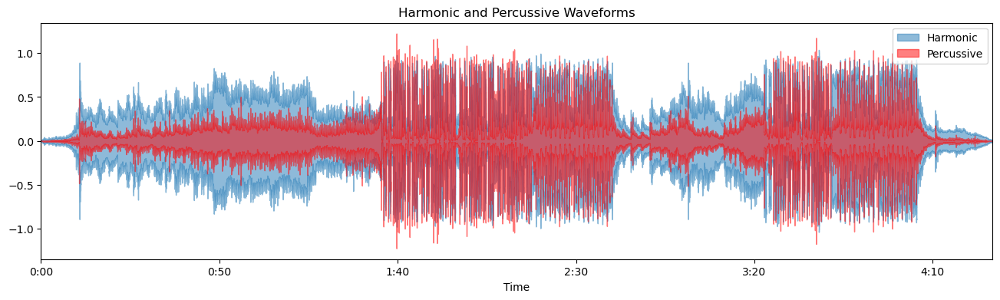

In [16]:
# Plotting the waveforms
plt.figure(figsize=(16, 4))

# Plot harmonic waveform
librosa.display.waveshow(y_harm, sr=sr, alpha=0.5, label='Harmonic')

# Plot percussive waveform
librosa.display.waveshow(y_perc, sr=sr, color='r', alpha=0.5, label='Percussive')

# Set x-axis
duration = librosa.get_duration(y=y, sr=sr)
plt.xlim(0, duration)

plt.title('Harmonic and Percussive Waveforms')
plt.legend()
plt.show()

ipd.display(ipd.Audio(y, rate=sr))

In [54]:
def compute_beats_per_measure(beats):
    """
    Calculate the most common number of beats per measure in an array of beat times.

    This function assumes the beat times are evenly spaced within each measure and that
    the most common inter-onset interval (IOI) between beats corresponds to the beat within a measure.
    It is also assumed that the beats array is sorted in ascending order of time.

    Parameters:
    beats : np.ndarray
        An array of beat times in frame units generated from librosa.beat.beat_track. This array should be one-dimensional and contain
        beat onset times in chronological order.

    Returns:
    beats_per_measure : int
        The estimated number of beats per measure, calculated by finding the most common
        inter-onset interval between consecutive beats and using it to determine the
        measure length.

    Raises:
    ValueError: If the `beats` array is empty or not one-dimensional.

    Example:
    >>> beats = np.array([0.5, 1.0, 1.5, 2.0, 3.0, 4.0])
    >>> compute_beats_per_measure(beats)
    4
    """
    # Validate input
    if beats.ndim != 1:
        raise ValueError("The 'beats' array must be one-dimensional.")
    if beats.size == 0:
        raise ValueError("The 'beats' array must not be empty.")

    # Compute inter-onset intervals (IOIs)
    iois = np.diff(beats)
    
    # Identify unique measure lengths based on IOIs
    measure_lengths = np.unique(iois)
    
    # Find the most common measure length
    most_common_measure_length = np.bincount(measure_lengths).argmax()

    # Count the number of beats in each measure
    beats_per_measure = round(len(beats) / most_common_measure_length)
    return beats_per_measure

In [53]:
iois = np.diff(beats)
measure_lengths = np.unique(iois)
    
# Find the most common measure length
most_common_measure_length = np.bincount(measure_lengths).argmax()
round(len(beats) / most_common_measure_length)

4

In [78]:
def quantize_beats(y, sr, hop_length, beats_per_measure):
    """
    Create grids of beat times and measure start times for the audio.

    Parameters:
    y : np.ndarray
        Audio time series
    sr : number
        Sampling rate of `y`
    hop_length : int
        Hop length for beat tracking
    beats_per_measure : int
        Number of beats per measure (time signature)

    Returns:
    beat_grid : np.ndarray
        Array of beat times
    measure_grid : np.ndarray
        Array of measure start times
    """
    # Track beats
    tempo, beats = librosa.beat.beat_track(y=y, sr=sr, hop_length=hop_length)
    onset_env = librosa.onset.onset_strength(y=y, sr=sr, hop_length=hop_length)
    backtracked_beats = librosa.onset.onset_backtrack(beats, onset_env)
    backtracked_beat_times = librosa.frames_to_time(backtracked_beats, sr=sr, hop_length=hop_length)

    # Get the first backtracked beat time
    first_beat_time = backtracked_beat_times[0]

    # Calculate the beat interval (seconds per beat)
    beat_interval = 60.0 / tempo

    # Calculate the number of beats before the first beat time
    beats_before_first = int(np.floor(first_beat_time / beat_interval))

    # Calculate the time of the first beat
    first_beat_start_time = first_beat_time - (beats_before_first % 1) * beat_interval

    # Calculate the time of the first measure
    measures_before_first = beats_before_first // beats_per_measure
    first_measure_time = first_beat_time - measures_before_first * beats_per_measure * beat_interval

    # Create beat grid
    song_duration = librosa.get_duration(y=y, sr=sr, hop_length=hop_length)
    backward_beats = np.arange(first_beat_start_time, -beat_interval, -beat_interval)[::-1]
    forward_beats = np.arange(first_beat_start_time, song_duration, beat_interval)
    beat_grid = np.concatenate((backward_beats, forward_beats[1:]))  # Exclude the first element to avoid duplication
    beat_grid = beat_grid[beat_grid >= 0]

    # Create measure grid
    backward_measures = np.arange(first_measure_time, -beats_per_measure * beat_interval, -beats_per_measure * beat_interval)[::-1]
    forward_measures = np.arange(first_measure_time, song_duration, beats_per_measure * beat_interval)
    measure_grid = np.concatenate((backward_measures, forward_measures[1:]))  # Exclude the first element to avoid duplication
    measure_grid = measure_grid[measure_grid >= 0]

    return beat_grid, measure_grid

In [22]:
def extract_features(y, sr):
    # Assuming y is the audio time series and sr is the sampling rate
    features = {
        'mfcc': librosa.feature.mfcc(y=y, sr=sr),
        'rms': librosa.feature.rms(y=y),
        'spectral_centroid': librosa.feature.spectral_centroid(y=y, sr=sr),
        'spectral_bandwidth': librosa.feature.spectral_bandwidth(y=y, sr=sr),
        'spectral_contrast': librosa.feature.spectral_contrast(y=y, sr=sr),
        'spectral_flatness': librosa.feature.spectral_flatness(y=y),
        'spectral_rolloff': librosa.feature.spectral_rolloff(y=y, sr=sr),
        'poly_features': librosa.feature.poly_features(y=y, sr=sr),
        'tonnetz': librosa.feature.tonnetz(y=y, sr=sr),
        'zero_crossing_rate': librosa.feature.zero_crossing_rate(y=y),
        # 'tempogram_ratio': librosa.feature.fourier_tempogram(y=y, sr=sr)  # This feature does not directly exist in librosa
    }
    # Flatten the features to get a single feature vector for the measure
    feature_vector = np.concatenate([np.mean(feat, axis=1) for feat in features.values()])
    return feature_vector

tempo, beats = librosa.beat.beat_track(y=y, sr=sr)
# Tempo is in beats per minute (BPM)
seconds_per_beat = 60.0 / tempo
# For 4 beats per measure
seconds_per_measure = 4 * seconds_per_beat
# sr is the sampling rate in samples per second (Hz)
window_length_samples = int(seconds_per_measure * sr)
window_length_samples
seconds_per_measure

2.6879999999999997

In [127]:
beat_times[59]

135.33866666666665

In [15]:
# Extract audio features. Here we use MFCCs for simplicity.
mfcc = librosa.feature.mfcc(y=y, sr=sr)

# Compute the constant-Q chromagram
chromagram = librosa.feature.chroma_cqt(y=y, sr=sr, hop_length=hop_length)

# Step 2: Compute the self-similarity matrix
sim_matrix = librosa.segment.recurrence_matrix(mfcc, mode='affinity', metric='cosine')

# Step 3: Path enhancement
sim_matrix = librosa.segment.path_enhance(sim_matrix, 15)

# Step 4: Temporal clustering using agglomerative clustering
tempo, beats = librosa.beat.beat_track(y=y, sr=sr)
boundaries, labels = librosa.segment.agglomerative(mfcc, k=4)
segment_times = librosa.frames_to_time(boundaries, sr=sr)

# Step 5: Align the segment boundaries with the quantized measure grid
beats_per_measure = compute_beats_per_measure(beats)
beat_grid, measure_grid = quantize_beats(y, sr, hop, beats_per_measure)

aligned_boundaries = np.searchsorted(measure_grid, segment_times)
aligned_boundaries_times = beat_grid[aligned_boundaries]

# Step 6: Display the structure
librosa.display.specshow(sim_matrix, sr=sr, x_axis='time', y_axis='time')
plt.title('Structured Segmentation')
for t in aligned_boundaries_times:
    plt.axvline(x=t, color='r')
plt.show()

NameError: name 'hop_length' is not defined